In [ ]:
pip install zip

  Using cached zip-0.0.2.tar.gz (3.0 kB)
  Preparing metadata (setup.py) ... done
  Using cached Flask_Admin-1.6.1-py3-none-any.whl.metadata (5.8 kB)
  Using cached Flask-Bootstrap-3.3.7.1.tar.gz (456 kB)
  Preparing metadata (setup.py) ... done
  Using cached Flask-Cache-0.13.1.tar.gz (45 kB)
  Preparing metadata (setup.py) ... done
  Using cached Flask_FlatPages-0.8.3-py3-none-any.whl.metadata (2.6 kB)
  Using cached Flask_Gravatar-0.5.0-py2.py3-none-any.whl.metadata (5.4 kB)
  Using cached Flask_Login-0.6.3-py3-none-any.whl.metadata (5.8 kB)
  Using cached flask_mail-0.10.0-py3-none-any.whl.metadata (2.1 kB)
  Using cached flask_pymongo-3.0.1-py3-none-any.whl.metadata (3.5 kB)
  Using cached Flask-Restless-0.17.0.tar.gz (42 kB)
  Preparing metadata (setup.py) ... done
  Using cached flask_sqlalchemy-3.1.1-py3-none-any.whl.metadata (3.4 kB)
  Using cached Flask-Themes-0.1.3.tar.gz (9.7 kB)
  Preparing metadata (setup.py) ... done
  Using cached Flask-Uploads-0.2.1.tar.gz (7.6 kB)
  P

In [ ]:
import zipfile

# Yüklenen zip dosyasının ismi
zip_filename = "data2.zip"

# Zip dosyasını çıkartma işlemi
with zipfile.ZipFile(zip_filename, 'r') as zip_ref:
    zip_ref.extractall("/content/")  # Çıkarılacak yer

#  Veri Yükleme

In [ ]:
import os
import shutil
import random
import numpy as np
import pandas as pd

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
# Veri yollarını tanımlama
data_dir = "data"
train_dir = os.path.join(data_dir, "train")
test_dir = os.path.join(data_dir, "test")

In [ ]:
# Test setini düzenleyen fonksiyon
def reorganize_test_set(test_dir, train_dir, samples_per_class=20):
    for class_name in os.listdir(test_dir):
        class_path = os.path.join(test_dir, class_name)
        train_class_path = os.path.join(train_dir, class_name)

        if not os.path.isdir(class_path):
            continue

        # Mevcut dosyaları karıştır ve belirtilen miktarda test verisi bırak
        all_files = os.listdir(class_path)
        random.shuffle(all_files)
        test_files = all_files[:samples_per_class]
        train_files = all_files[samples_per_class:]

        # Hedef dizin varsa devam et, yoksa oluştur
        os.makedirs(train_class_path, exist_ok=True)

        # Test dosyalarını koru, diğerlerini train klasörüne taşı
        for file in train_files:
            src = os.path.join(class_path, file)
            dest = os.path.join(train_class_path, file)
            shutil.move(src, dest)

In [ ]:
# Test setini yeniden düzenle
reorganize_test_set(test_dir, train_dir)

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2
)

In [ ]:
valid_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
test_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
# Veri yolları
train_path = "data/train"
valid_path = "data/valid"
test_path = "data/test"

In [ ]:
# Veri setlerinin oluşturulması
train_data = train_datagen.flow_from_directory(
    train_path, target_size=(224, 224), batch_size=32, class_mode='categorical'
)

Found 499 images belonging to 4 classes.


In [ ]:
valid_data = valid_datagen.flow_from_directory(
    valid_path, target_size=(224, 224), batch_size=32, class_mode='categorical'
)

Found 72 images belonging to 4 classes.


In [ ]:
test_data = test_datagen.flow_from_directory(
    test_path, target_size=(224, 224), batch_size=32, class_mode='categorical', shuffle=False
)

Found 80 images belonging to 4 classes.


# Keşifsel Veri Analizi


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix

In [ ]:
import torchvision.transforms as T
from torchvision import datasets, transforms
import torch

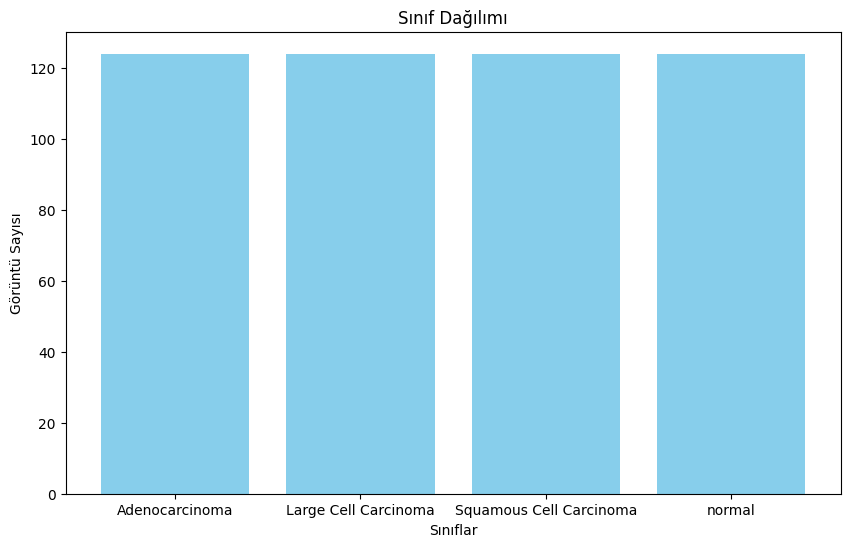

In [ ]:
# Sınıf dağılımını inceleme
class_counts = {k: train_data.samples // len(train_data.class_indices) for k, v in train_data.class_indices.items()}
# Assuming balanced classes, divide total samples by number of classes
plt.figure(figsize=(10, 6))
plt.bar(class_counts.keys(), class_counts.values(), color='skyblue')
plt.title("Sınıf Dağılımı")
plt.xlabel("Sınıflar")
plt.ylabel("Görüntü Sayısı")
plt.show()

In [ ]:
# Görselleştirme için kullanılan dönüşümler (veriyi normalize etme)
val_test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
"""
# Train veri setinde sınıfları görselleştir
train_dataset = datasets.ImageFolder(os.path.join(data_dir, 'train'), transform=val_test_transform)
class_names = train_dataset.classes"""

In [ ]:
# Sınıflardan örnek görselleri seçme ve görselleştirme
def visualize_class_samples(dataset, class_names):
    class_to_idx = dataset.class_to_idx
    idx_to_class = {v: k for k, v in class_to_idx.items()}  # class_to_idx'yi tersine çevir

    samples = {}
    for img, label in dataset:
        if label not in samples:  # Her sınıf için bir örnek al
            samples[label] = img
        if len(samples) == len(class_names):  # Tüm sınıflardan örnek alındığında dur
            break

    # Görselleri görselleştirme
    plt.figure(figsize=(12, 8))
    for i, (label, img) in enumerate(samples.items()):
        img = img.permute(1, 2, 0)  # (C, H, W) -> (H, W, C) dönüşümü
        img = img * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # Normalize'ı geri al
        img = img.clamp(0, 1)  # Piksel değerlerini 0-1 aralığına getir

        plt.subplot(1, len(samples), i + 1)
        plt.imshow(img)
        plt.title(f"Class: {idx_to_class[label]}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

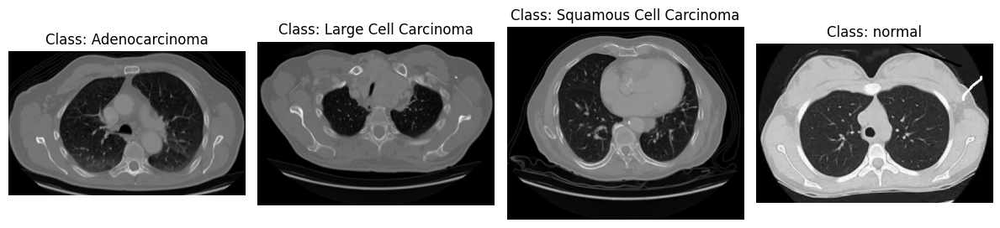

In [ ]:
# Train veri setinde sınıfları görselleştir
train_dataset = datasets.ImageFolder(os.path.join(data_dir, 'train'), transform=val_test_transform)
class_names = train_dataset.classes
visualize_class_samples(train_dataset, class_names)

# Veri Ön İşleme

In [ ]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import os

In [ ]:
# Veri dönüşümleri
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
val_test_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
# Veri yükleme fonksiyonu
def load_data(data_dir, batch_size=32):
    # Veri setlerini oluştur
    train_dataset = datasets.ImageFolder(
        os.path.join(data_dir, 'train'),
        transform=train_transform
    )

    valid_dataset = datasets.ImageFolder(
        os.path.join(data_dir, 'valid'),
        transform=val_test_transform
    )

    test_dataset = datasets.ImageFolder(
        os.path.join(data_dir, 'test'),
        transform=val_test_transform
    )

    # DataLoader'ları oluştur
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=4
    )

    valid_loader = DataLoader(
        valid_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=4
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=4
    )

    print(f"Number of training images: {len(train_dataset)}")
    print(f"Number of validation images: {len(valid_dataset)}")
    print(f"Number of test images: {len(test_dataset)}")
    print(f"\nClasses: {train_dataset.classes}")

    return train_loader, valid_loader, test_loader, len(train_dataset.classes)

# Modelleme

In [ ]:
pip install --upgrade torchvision torch

In [ ]:
import torch
import torchvision
print(torch.__version__)
print(torchvision.__version__)

2.6.0+cu124
0.21.0+cu124


In [ ]:
import torch.nn as nn
from torchvision.models import resnet50, densenet121, ResNet50_Weights, DenseNet121_Weights,efficientnet_b0, mobilenet_v2, EfficientNet_B0_Weights, MobileNet_V2_Weights
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
from sklearn.metrics import confusion_matrix
import copy
from collections import defaultdict

In [ ]:
# GPU kontrolü
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda:0


In [ ]:
# Veri yükleme
data_dir = 'data'  # Veri setinizin bulunduğu klasör
train_loader, valid_loader, test_loader, num_classes = load_data(data_dir)

Number of training images: 499
Number of validation images: 72
Number of test images: 80

Classes: ['Adenocarcinoma', 'Large Cell Carcinoma', 'Squamous Cell Carcinoma', 'normal']


## EfficientNet

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.models import efficientnet_b0, mobilenet_v2, EfficientNet_B0_Weights, MobileNet_V2_Weights
import copy
from torchvision import datasets, transforms, models

In [ ]:
# EfficientNet Model Tanımlama
class EfficientNetLungCancer(nn.Module):
    def __init__(self, num_classes, use_pretrained=True):
        super(EfficientNetLungCancer, self).__init__()
        if use_pretrained:
            self.efficientnet = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.IMAGENET1K_V1)
        else:
            self.efficientnet = models.efficientnet_b0(weights=None)

        num_ftrs = self.efficientnet.classifier[1].in_features
        self.efficientnet.classifier = nn.Identity()

        self.fc = nn.Sequential(
            nn.Linear(num_ftrs, 256),
            nn.ReLU(),
            nn.Dropout(0.7),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        x = self.efficientnet(x)
        return self.fc(x)

In [ ]:
# Model Oluşturma
efficientnet_model = EfficientNetLungCancer(num_classes)
efficientnet_model = efficientnet_model.to(device)

In [ ]:
# Loss ve Optimizer
criterion_efficientnet = nn.CrossEntropyLoss()
optimizer_efficientnet = optim.Adam([
    {'params': efficientnet_model.efficientnet.parameters(), 'lr': 1e-5},
    {'params': efficientnet_model.fc.parameters(), 'lr': 1e-4}
], weight_decay=1e-6)

scheduler_efficientnet = ReduceLROnPlateau(optimizer_efficientnet, mode='max', factor=0.5, patience=7)

In [ ]:
# Eğitim Döngüsü
efficientnet_history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
best_efficientnet_acc = 0.0
best_efficientnet_wts = None

In [ ]:
num_epochs = 60

In [ ]:
for epoch in range(num_epochs):
    print(f'EfficientNet - Epoch {epoch}/{num_epochs - 1}')
    print('-' * 10)

    # Eğitim Aşaması
    efficientnet_model.train()
    running_loss = 0.0
    running_corrects = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_efficientnet.zero_grad()
        outputs = efficientnet_model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion_efficientnet(outputs, labels)

        loss.backward()
        optimizer_efficientnet.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)
    efficientnet_history['train_loss'].append(epoch_loss)
    efficientnet_history['train_acc'].append(epoch_acc.cpu())

    # Validasyon Aşaması
    efficientnet_model.eval()
    running_loss = 0.0
    running_corrects = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = efficientnet_model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion_efficientnet(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(valid_loader.dataset)
    epoch_acc = running_corrects.double() / len(valid_loader.dataset)
    efficientnet_history['val_loss'].append(epoch_loss)
    efficientnet_history['val_acc'].append(epoch_acc.cpu())

    scheduler_efficientnet.step(epoch_acc)

    if epoch_acc > best_efficientnet_acc:
        best_efficientnet_acc = epoch_acc
        best_efficientnet_wts = copy.deepcopy(efficientnet_model.state_dict())

    print(f'Train Loss: {efficientnet_history["train_loss"][-1]:.4f} Acc: {efficientnet_history["train_acc"][-1]:.4f}')
    print(f'Val Loss: {efficientnet_history["val_loss"][-1]:.4f} Acc: {efficientnet_history["val_acc"][-1]:.4f}')
    print()

efficientnet_model.load_state_dict(best_efficientnet_wts)
torch.save(efficientnet_model.state_dict(), 'lung_cancer_efficientnet_model.pth')

EfficientNet - Epoch 0/59
----------
Train Loss: 1.3816 Acc: 0.2565
Val Loss: 1.3561 Acc: 0.2917

EfficientNet - Epoch 1/59
----------
Train Loss: 1.3112 Acc: 0.4208
Val Loss: 1.3485 Acc: 0.3472

EfficientNet - Epoch 2/59
----------
Train Loss: 1.2489 Acc: 0.5170
Val Loss: 1.3281 Acc: 0.3472

EfficientNet - Epoch 3/59
----------
Train Loss: 1.1780 Acc: 0.5531
Val Loss: 1.2667 Acc: 0.3472

EfficientNet - Epoch 4/59
----------
Train Loss: 1.1137 Acc: 0.5591
Val Loss: 1.2018 Acc: 0.3472

EfficientNet - Epoch 5/59
----------
Train Loss: 1.0543 Acc: 0.5852
Val Loss: 1.1325 Acc: 0.3472

EfficientNet - Epoch 6/59
----------
Train Loss: 0.9654 Acc: 0.6132
Val Loss: 1.0960 Acc: 0.3472

EfficientNet - Epoch 7/59
----------
Train Loss: 0.9597 Acc: 0.5972
Val Loss: 1.0580 Acc: 0.3889

EfficientNet - Epoch 8/59
----------
Train Loss: 0.9239 Acc: 0.5932
Val Loss: 1.0341 Acc: 0.3750

EfficientNet - Epoch 9/59
----------
Train Loss: 0.9090 Acc: 0.5872
Val Loss: 1.0084 Acc: 0.3889

EfficientNet - Epoch

## CNN

In [ ]:
# Custom CNN Model
class SimpleCNN(nn.Module):
    def __init__(self, num_classes):
        super(SimpleCNN, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )

        self.classifier = nn.Sequential(
            nn.Linear(512 * 14 * 14, 512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

In [ ]:
# Model Oluşturma
cnn_model = SimpleCNN(num_classes)
cnn_model = cnn_model.to(device)

In [ ]:
# Loss ve Optimizer
criterion_cnn = nn.CrossEntropyLoss()
optimizer_cnn = optim.Adam(cnn_model.parameters(), lr=1e-4, weight_decay=1e-6)
scheduler_cnn = ReduceLROnPlateau(optimizer_cnn, mode='max', factor=0.5, patience=7)

In [ ]:
# Eğitim Döngüsü
cnn_history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
best_cnn_acc = 0.0
best_cnn_wts = None

In [ ]:
num_epochs=60

In [ ]:
for epoch in range(num_epochs):
    print(f'CNN - Epoch {epoch}/{num_epochs - 1}')
    print('-' * 10)

    # Eğitim Aşaması
    cnn_model.train()
    running_loss = 0.0
    running_corrects = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_cnn.zero_grad()
        outputs = cnn_model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion_cnn(outputs, labels)

        loss.backward()
        optimizer_cnn.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)
    cnn_history['train_loss'].append(epoch_loss)
    cnn_history['train_acc'].append(epoch_acc.cpu())

    # Validasyon Aşaması
    cnn_model.eval()
    running_loss = 0.0
    running_corrects = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = cnn_model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion_cnn(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(valid_loader.dataset)
    epoch_acc = running_corrects.double() / len(valid_loader.dataset)
    cnn_history['val_loss'].append(epoch_loss)
    cnn_history['val_acc'].append(epoch_acc.cpu())

    scheduler_cnn.step(epoch_acc)

    if epoch_acc > best_cnn_acc:
        best_cnn_acc = epoch_acc
        best_cnn_wts = copy.deepcopy(cnn_model.state_dict())

    print(f'Train Loss: {cnn_history["train_loss"][-1]:.4f} Acc: {cnn_history["train_acc"][-1]:.4f}')
    print(f'Val Loss: {cnn_history["val_loss"][-1]:.4f} Acc: {cnn_history["val_acc"][-1]:.4f}')
    print()

cnn_model.load_state_dict(best_cnn_wts)
torch.save(cnn_model.state_dict(), 'lung_cancer_cnn_model.pth')

CNN - Epoch 0/59
----------
Train Loss: 1.1982 Acc: 0.4449
Val Loss: 1.1250 Acc: 0.3472

CNN - Epoch 1/59
----------
Train Loss: 1.0395 Acc: 0.5531
Val Loss: 1.1767 Acc: 0.3750

CNN - Epoch 2/59
----------
Train Loss: 0.9917 Acc: 0.5591
Val Loss: 1.1078 Acc: 0.3611

CNN - Epoch 3/59
----------
Train Loss: 1.0104 Acc: 0.5471
Val Loss: 1.0994 Acc: 0.3750

CNN - Epoch 4/59
----------
Train Loss: 0.9467 Acc: 0.5711
Val Loss: 1.1537 Acc: 0.3750

CNN - Epoch 5/59
----------
Train Loss: 1.0036 Acc: 0.5491
Val Loss: 1.2149 Acc: 0.3750

CNN - Epoch 6/59
----------
Train Loss: 0.9212 Acc: 0.5591
Val Loss: 1.2260 Acc: 0.3750

CNN - Epoch 7/59
----------
Train Loss: 0.9337 Acc: 0.5631
Val Loss: 1.0978 Acc: 0.3750

CNN - Epoch 8/59
----------
Train Loss: 0.9303 Acc: 0.5711
Val Loss: 1.1542 Acc: 0.3750

CNN - Epoch 9/59
----------
Train Loss: 0.9187 Acc: 0.5872
Val Loss: 1.0149 Acc: 0.4444

CNN - Epoch 10/59
----------
Train Loss: 0.8703 Acc: 0.5792
Val Loss: 1.0668 Acc: 0.4444

CNN - Epoch 11/59
--

## MobileNetV2

In [ ]:
class MobileNetV2LungCancer(nn.Module):
    def __init__(self, num_classes, use_pretrained=True):
        super(MobileNetV2LungCancer, self).__init__()
        if use_pretrained:
            self.mobilenet = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.IMAGENET1K_V1)
        else:
            self.mobilenet = models.mobilenet_v2(weights=None)

        num_ftrs = self.mobilenet.classifier[1].in_features
        self.mobilenet.classifier = nn.Identity()

        self.fc = nn.Sequential(
            nn.Linear(num_ftrs, 256),
            nn.ReLU(),
            nn.Dropout(0.7),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        x = self.mobilenet(x)
        return self.fc(x)

In [ ]:
# Model Oluşturma
mobilenet_model = MobileNetV2LungCancer(num_classes)
mobilenet_model = mobilenet_model.to(device)

In [ ]:
# Loss ve Optimizer
criterion_mobilenet = nn.CrossEntropyLoss()
optimizer_mobilenet = optim.Adam([
    {'params': mobilenet_model.mobilenet.parameters(), 'lr': 1e-5},
    {'params': mobilenet_model.fc.parameters(), 'lr': 1e-4}
], weight_decay=1e-6)

scheduler_mobilenet = ReduceLROnPlateau(optimizer_mobilenet, mode='max', factor=0.5, patience=7)

In [ ]:
# Eğitim Döngüsü
mobilenet_history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
best_mobilenet_acc = 0.0
best_mobilenet_wts = None

In [ ]:
num_epochs = 60

In [ ]:
for epoch in range(num_epochs):
    print(f'MobileNetV2 - Epoch {epoch}/{num_epochs - 1}')
    print('-' * 10)

    # Eğitim Aşaması
    mobilenet_model.train()
    running_loss = 0.0
    running_corrects = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_mobilenet.zero_grad()
        outputs = mobilenet_model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion_mobilenet(outputs, labels)

        loss.backward()
        optimizer_mobilenet.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)
    mobilenet_history['train_loss'].append(epoch_loss)
    mobilenet_history['train_acc'].append(epoch_acc.cpu())

    # Validasyon Aşaması
    mobilenet_model.eval()
    running_loss = 0.0
    running_corrects = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = mobilenet_model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion_mobilenet(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(valid_loader.dataset)
    epoch_acc = running_corrects.double() / len(valid_loader.dataset)
    mobilenet_history['val_loss'].append(epoch_loss)
    mobilenet_history['val_acc'].append(epoch_acc.cpu())

    scheduler_mobilenet.step(epoch_acc)

    if epoch_acc > best_mobilenet_acc:
        best_mobilenet_acc = epoch_acc
        best_mobilenet_wts = copy.deepcopy(mobilenet_model.state_dict())

    print(f'Train Loss: {mobilenet_history["train_loss"][-1]:.4f} Acc: {mobilenet_history["train_acc"][-1]:.4f}')
    print(f'Val Loss: {mobilenet_history["val_loss"][-1]:.4f} Acc: {mobilenet_history["val_acc"][-1]:.4f}')
    print()

mobilenet_model.load_state_dict(best_mobilenet_wts)
torch.save(mobilenet_model.state_dict(), 'lung_cancer_mobilenetv2_model.pth')

MobileNetV2 - Epoch 0/59
----------
Train Loss: 1.3529 Acc: 0.3547
Val Loss: 1.4093 Acc: 0.2639

MobileNetV2 - Epoch 1/59
----------
Train Loss: 1.2349 Acc: 0.4830
Val Loss: 1.2960 Acc: 0.3611

MobileNetV2 - Epoch 2/59
----------
Train Loss: 1.1105 Acc: 0.5351
Val Loss: 1.1560 Acc: 0.3750

MobileNetV2 - Epoch 3/59
----------
Train Loss: 1.0386 Acc: 0.5511
Val Loss: 1.0763 Acc: 0.3750

MobileNetV2 - Epoch 4/59
----------
Train Loss: 0.9749 Acc: 0.5731
Val Loss: 1.0447 Acc: 0.4167

MobileNetV2 - Epoch 5/59
----------
Train Loss: 0.9141 Acc: 0.5792
Val Loss: 1.0155 Acc: 0.3889

MobileNetV2 - Epoch 6/59
----------
Train Loss: 0.9056 Acc: 0.5792
Val Loss: 0.9949 Acc: 0.4444

MobileNetV2 - Epoch 7/59
----------
Train Loss: 0.8772 Acc: 0.5932
Val Loss: 0.9821 Acc: 0.4583

MobileNetV2 - Epoch 8/59
----------
Train Loss: 0.8649 Acc: 0.6253
Val Loss: 0.9633 Acc: 0.4861

MobileNetV2 - Epoch 9/59
----------
Train Loss: 0.8626 Acc: 0.6393
Val Loss: 0.9701 Acc: 0.4722

MobileNetV2 - Epoch 10/59
----

## U-Net++

In [ ]:
class UNetPlusPlus(nn.Module):
    def __init__(self, num_classes):
        super(UNetPlusPlus, self).__init__()

        # Encoder (with deeper structure and pretrained weights)
        self.enc1 = self._make_encoder_block(3, 64)
        self.enc2 = self._make_encoder_block(64, 128)
        self.enc3 = self._make_encoder_block(128, 256)
        self.enc4 = self._make_encoder_block(256, 512)

        # Decoder
        self.dec1 = self._make_decoder_block(512, 256)
        self.dec2 = self._make_decoder_block(256, 128)
        self.dec3 = self._make_decoder_block(128, 64)

        # Skip connections (improved with SE blocks)
        self.skip1 = self._make_se_block(64)
        self.skip2 = self._make_se_block(128)
        self.skip3 = self._make_se_block(256)

        # Classification head
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.classifier = nn.Sequential(
            nn.Linear(64, 256),
            nn.ReLU(),
            nn.Dropout(0.2),  # Dropout rate increased for better regularization
            nn.Linear(256, num_classes)
        )

    def _make_encoder_block(self, in_channels, out_channels):
        """Creates an encoder block."""
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(2, 2)
        )

    def _make_decoder_block(self, in_channels, out_channels):
        """Creates a decoder block."""
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, 2, stride=2),
            nn.Conv2d(out_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def _make_se_block(self, channels, reduction=16):
        """Creates a Squeeze-and-Excitation (SE) block."""
        return nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(channels, channels // reduction, 1, bias=False),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels // reduction, channels, 1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Encoder
        e1 = self.enc1(x)
        e2 = self.enc2(e1)
        e3 = self.enc3(e2)
        e4 = self.enc4(e3)

        # Decoder with skip connections
        d1 = self.dec1(e4) + self.skip3(e3) * e3
        d2 = self.dec2(d1) + self.skip2(e2) * e2
        d3 = self.dec3(d2) + self.skip1(e1) * e1

        # Classification
        x = self.avgpool(d3)
        x = torch.flatten(x, 1)
        x = self.classifier(x)
        return x

In [ ]:
unetpp_model = UNetPlusPlus(num_classes).to(device)

In [ ]:
criterion_unetpp = nn.CrossEntropyLoss()

In [ ]:
optimizer_unetpp = optim.Adam(unetpp_model.parameters(), lr=1e-4, weight_decay=1e-6)

In [ ]:
scheduler_unetpp = ReduceLROnPlateau(optimizer_unetpp, mode='max', factor=0.5, patience=7)

In [ ]:
# U-Net++ eğitim döngüsü
unetpp_history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
best_unetpp_acc = 0.0
best_unetpp_wts = None

In [ ]:
num_epochs = 60

In [ ]:
for epoch in range(num_epochs):
    print(f'U-Net++ - Epoch {epoch}/{num_epochs - 1}')
    print('-' * 10)

    # Eğitim aşaması
    unetpp_model.train()
    running_loss = 0.0
    running_corrects = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_unetpp.zero_grad()
        outputs = unetpp_model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion_unetpp(outputs, labels)

        loss.backward()
        optimizer_unetpp.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)
    unetpp_history['train_loss'].append(epoch_loss)
    unetpp_history['train_acc'].append(epoch_acc.cpu())

    # Validasyon aşaması
    unetpp_model.eval()
    running_loss = 0.0
    running_corrects = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = unetpp_model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion_unetpp(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(valid_loader.dataset)
    epoch_acc = running_corrects.double() / len(valid_loader.dataset)
    unetpp_history['val_loss'].append(epoch_loss)
    unetpp_history['val_acc'].append(epoch_acc.cpu())

    scheduler_unetpp.step(epoch_acc)

    if epoch_acc > best_unetpp_acc:
        best_unetpp_acc = epoch_acc
        best_unetpp_wts = copy.deepcopy(unetpp_model.state_dict())

    print(f'Train Loss: {unetpp_history["train_loss"][-1]:.4f} Acc: {unetpp_history["train_acc"][-1]:.4f}')
    print(f'Val Loss: {unetpp_history["val_loss"][-1]:.4f} Acc: {unetpp_history["val_acc"][-1]:.4f}')
    print()

unetpp_model.load_state_dict(best_unetpp_wts)
torch.save(unetpp_model.state_dict(), 'lung_cancer_unetpp_model.pth')

U-Net++ - Epoch 0/59
----------
Train Loss: 1.2664 Acc: 0.4008
Val Loss: 1.3558 Acc: 0.3194

U-Net++ - Epoch 1/59
----------
Train Loss: 1.1245 Acc: 0.5451
Val Loss: 1.2495 Acc: 0.3611

U-Net++ - Epoch 2/59
----------
Train Loss: 1.0461 Acc: 0.5631
Val Loss: 1.1229 Acc: 0.3889

U-Net++ - Epoch 3/59
----------
Train Loss: 1.0413 Acc: 0.5691
Val Loss: 1.0916 Acc: 0.3889

U-Net++ - Epoch 4/59
----------
Train Loss: 0.9854 Acc: 0.5752
Val Loss: 1.0706 Acc: 0.3889

U-Net++ - Epoch 5/59
----------
Train Loss: 0.9965 Acc: 0.5591
Val Loss: 1.0617 Acc: 0.3889

U-Net++ - Epoch 6/59
----------
Train Loss: 0.9807 Acc: 0.5752
Val Loss: 1.0627 Acc: 0.3889

U-Net++ - Epoch 7/59
----------
Train Loss: 0.9550 Acc: 0.5731
Val Loss: 1.0459 Acc: 0.3889

U-Net++ - Epoch 8/59
----------
Train Loss: 0.9617 Acc: 0.5711
Val Loss: 1.0575 Acc: 0.3889

U-Net++ - Epoch 9/59
----------
Train Loss: 0.9522 Acc: 0.5752
Val Loss: 1.0309 Acc: 0.3889

U-Net++ - Epoch 10/59
----------
Train Loss: 0.9219 Acc: 0.5812
Val Lo

## DenseNet121

In [ ]:
class DenseNetLungCancer(nn.Module):
    def __init__(self, num_classes, use_pretrained=True):
        super(DenseNetLungCancer, self).__init__()
        if use_pretrained:
            weights = DenseNet121_Weights.IMAGENET1K_V1
        else:
            weights = None

        self.densenet = densenet121(weights=weights)
        num_ftrs = self.densenet.classifier.in_features
        self.densenet.classifier = nn.Identity()

        self.fc = nn.Sequential(
            nn.Linear(num_ftrs, 256),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        x = self.densenet(x)
        return self.fc(x)

In [ ]:
densenet_model = DenseNetLungCancer(num_classes).to(device)
criterion_densenet = nn.CrossEntropyLoss()

Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 182MB/s]


In [ ]:
optimizer_densenet = optim.Adam([
    {'params': densenet_model.densenet.parameters(), 'lr': 1e-5},
    {'params': densenet_model.fc.parameters(), 'lr': 1e-4}
], weight_decay=1e-6)

In [ ]:
scheduler_densenet = ReduceLROnPlateau(optimizer_densenet, mode='max', factor=0.5, patience=7)

In [ ]:
# DenseNet121 eğitim döngüsü
densenet_history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
best_densenet_acc = 0.0
best_densenet_wts = None

In [ ]:
num_epochs = 60

In [ ]:
for epoch in range(num_epochs):
    print(f'DenseNet121 - Epoch {epoch}/{num_epochs - 1}')
    print('-' * 10)

    # Eğitim aşaması
    densenet_model.train()
    running_loss = 0.0
    running_corrects = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_densenet.zero_grad()
        outputs = densenet_model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion_densenet(outputs, labels)

        loss.backward()
        optimizer_densenet.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)
    densenet_history['train_loss'].append(epoch_loss)
    densenet_history['train_acc'].append(epoch_acc.cpu())

    # Validasyon aşaması
    densenet_model.eval()
    running_loss = 0.0
    running_corrects = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = densenet_model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion_densenet(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(valid_loader.dataset)
    epoch_acc = running_corrects.double() / len(valid_loader.dataset)
    densenet_history['val_loss'].append(epoch_loss)
    densenet_history['val_acc'].append(epoch_acc.cpu())

    scheduler_densenet.step(epoch_acc)

    if epoch_acc > best_densenet_acc:
        best_densenet_acc = epoch_acc
        best_densenet_wts = copy.deepcopy(densenet_model.state_dict())

    print(f'Train Loss: {densenet_history["train_loss"][-1]:.4f} Acc: {densenet_history["train_acc"][-1]:.4f}')
    print(f'Val Loss: {densenet_history["val_loss"][-1]:.4f} Acc: {densenet_history["val_acc"][-1]:.4f}')
    print()

densenet_model.load_state_dict(best_densenet_wts)
torch.save(densenet_model.state_dict(), 'lung_cancer_densenet121_model.pth')

# U-Net++ Modeli Eğitimi
unetpp_model = UNetPlusPlus(num_classes).to(device)
criterion_unetpp = nn.CrossEntropyLoss()
optimizer_unetpp = optim.Adam(unetpp_model.parameters(), lr=1e-4, weight_decay=1e-6)
scheduler_unetpp = ReduceLROnPlateau(optimizer_unetpp, mode='max', factor=0.5, patience=7)

DenseNet121 - Epoch 0/59
----------
Train Loss: 1.3422 Acc: 0.3567
Val Loss: 1.4795 Acc: 0.2083

DenseNet121 - Epoch 1/59
----------
Train Loss: 1.2685 Acc: 0.4509
Val Loss: 1.3991 Acc: 0.2639

DenseNet121 - Epoch 2/59
----------
Train Loss: 1.1770 Acc: 0.5311
Val Loss: 1.2911 Acc: 0.3333

DenseNet121 - Epoch 3/59
----------
Train Loss: 1.1005 Acc: 0.5251
Val Loss: 1.1922 Acc: 0.3611

DenseNet121 - Epoch 4/59
----------
Train Loss: 1.0059 Acc: 0.5752
Val Loss: 1.1641 Acc: 0.3333

DenseNet121 - Epoch 5/59
----------
Train Loss: 0.9383 Acc: 0.6032
Val Loss: 1.0842 Acc: 0.3611

DenseNet121 - Epoch 6/59
----------
Train Loss: 0.9262 Acc: 0.6112
Val Loss: 1.0736 Acc: 0.3611

DenseNet121 - Epoch 7/59
----------
Train Loss: 0.8692 Acc: 0.6132
Val Loss: 1.0388 Acc: 0.3750

DenseNet121 - Epoch 8/59
----------
Train Loss: 0.8765 Acc: 0.6132
Val Loss: 1.0432 Acc: 0.3611

DenseNet121 - Epoch 9/59
----------
Train Loss: 0.8518 Acc: 0.6293
Val Loss: 1.0289 Acc: 0.3750

DenseNet121 - Epoch 10/59
----

## Resnet50

In [ ]:
class ResNetLungCancer(nn.Module):
    def __init__(self, num_classes, use_pretrained=True):
        super(ResNetLungCancer, self).__init__()
        if use_pretrained:
            weights = ResNet50_Weights.IMAGENET1K_V1
        else:
            weights = None

        self.resnet = resnet50(weights=weights)
        num_ftrs = self.resnet.fc.in_features
        self.resnet.fc = nn.Identity()

        self.fc = nn.Sequential(
            nn.Linear(num_ftrs, 256),
            nn.ReLU(),
            nn.Dropout(0.7),
            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        x = self.resnet(x)
        return self.fc(x)

In [ ]:
# Model oluşturma
resnet_model = ResNetLungCancer(num_classes)
resnet_model = resnet_model .to(device)

In [ ]:
criterion_resnet = nn.CrossEntropyLoss()

In [ ]:
# Farklı öğrenme oranları için parametre grupları
pretrained_params = list(resnet_model.resnet.parameters())
new_params = list(resnet_model.fc.parameters())

In [ ]:
optimizer_resnet = optim.Adam([
    {'params': resnet_model.resnet.parameters(), 'lr': 1e-5},
    {'params': resnet_model.fc.parameters(), 'lr': 1e-4}
], weight_decay=1e-6)

In [ ]:
scheduler_resnet = ReduceLROnPlateau(optimizer_resnet, mode='max', factor=0.5, patience=7)

In [ ]:
# ResNet50 eğitim döngüsü
resnet_history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
best_resnet_acc = 0.0
best_resnet_wts = None

In [ ]:
# Model eğitimi
num_epochs = 60

In [ ]:
for epoch in range(num_epochs):
    print(f'ResNet50 - Epoch {epoch}/{num_epochs - 1}')
    print('-' * 10)

    # Eğitim aşaması
    resnet_model.train()
    running_loss = 0.0
    running_corrects = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_resnet.zero_grad()
        outputs = resnet_model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion_resnet(outputs, labels)

        loss.backward()
        optimizer_resnet.step()

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = running_corrects.double() / len(train_loader.dataset)
    resnet_history['train_loss'].append(epoch_loss)
    resnet_history['train_acc'].append(epoch_acc.cpu())

    # Validasyon aşaması
    resnet_model.eval()
    running_loss = 0.0
    running_corrects = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = resnet_model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion_resnet(outputs, labels)

            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)

    epoch_loss = running_loss / len(valid_loader.dataset)
    epoch_acc = running_corrects.double() / len(valid_loader.dataset)
    resnet_history['val_loss'].append(epoch_loss)
    resnet_history['val_acc'].append(epoch_acc.cpu())

    scheduler_resnet.step(epoch_acc)

    if epoch_acc > best_resnet_acc:
        best_resnet_acc = epoch_acc
        best_resnet_wts = copy.deepcopy(resnet_model.state_dict())

    print(f'Train Loss: {resnet_history["train_loss"][-1]:.4f} Acc: {resnet_history["train_acc"][-1]:.4f}')
    print(f'Val Loss: {resnet_history["val_loss"][-1]:.4f} Acc: {resnet_history["val_acc"][-1]:.4f}')
    print()

resnet_model.load_state_dict(best_resnet_wts)
torch.save(resnet_model.state_dict(), 'lung_cancer_resnet50_model.pth')

ResNet50 - Epoch 0/59
----------
Train Loss: 1.3539 Acc: 0.3747
Val Loss: 1.4455 Acc: 0.3333

ResNet50 - Epoch 1/59
----------
Train Loss: 1.2547 Acc: 0.4910
Val Loss: 1.3266 Acc: 0.3611

ResNet50 - Epoch 2/59
----------
Train Loss: 1.1216 Acc: 0.5591
Val Loss: 1.1765 Acc: 0.3611

ResNet50 - Epoch 3/59
----------
Train Loss: 1.0146 Acc: 0.5511
Val Loss: 1.0962 Acc: 0.3611

ResNet50 - Epoch 4/59
----------
Train Loss: 0.9350 Acc: 0.5872
Val Loss: 1.0873 Acc: 0.3611

ResNet50 - Epoch 5/59
----------
Train Loss: 0.8975 Acc: 0.6012
Val Loss: 1.0321 Acc: 0.3611

ResNet50 - Epoch 6/59
----------
Train Loss: 0.8947 Acc: 0.5872
Val Loss: 1.0157 Acc: 0.3750

ResNet50 - Epoch 7/59
----------
Train Loss: 0.8311 Acc: 0.6152
Val Loss: 1.0225 Acc: 0.3750

ResNet50 - Epoch 8/59
----------
Train Loss: 0.8338 Acc: 0.6092
Val Loss: 0.9860 Acc: 0.4028

ResNet50 - Epoch 9/59
----------
Train Loss: 0.8157 Acc: 0.6553
Val Loss: 0.9884 Acc: 0.4028

ResNet50 - Epoch 10/59
----------
Train Loss: 0.8068 Acc: 0.

# Modellerin Karşılaştırılması

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc

In [ ]:
def plot_training_curves(histories, model_names):
    """Eğitim ve validasyon eğrilerini çizme"""
    plt.figure(figsize=(15, 5))

    # Loss eğrileri
    plt.subplot(1, 2, 1)
    for history, name in zip(histories, model_names):
        plt.plot(history['train_loss'], label=f'{name} (Train)')
        plt.plot(history['val_loss'], label=f'{name} (Val)')
    plt.title('Model Loss Curves')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    # Accuracy eğrileri
    plt.subplot(1, 2, 2)
    for history, name in zip(histories, model_names):
        plt.plot(history['train_acc'], label=f'{name} (Train)')
        plt.plot(history['val_acc'], label=f'{name} (Val)')
    plt.title('Model Accuracy Curves')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

In [ ]:
def evaluate_model(model, test_loader, device):
    """Model değerlendirme metrikleri"""
    model.eval()
    all_preds = []
    all_labels = []
    all_probs = []

    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            probs = torch.softmax(outputs, dim=1)
            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())
            all_probs.extend(probs.cpu().numpy())

    return np.array(all_preds), np.array(all_labels), np.array(all_probs)

In [ ]:
def plot_confusion_matrices(models, model_names, test_loader, device, class_names):
    """Karışıklık matrislerini çizme"""
    plt.figure(figsize=(50, 10))

    for idx, (model, name) in enumerate(zip(models, model_names), 1):
        preds, labels, _ = evaluate_model(model, test_loader, device)
        cm = confusion_matrix(labels, preds)

        plt.subplot(1, 6, idx)
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                   xticklabels=class_names, yticklabels=class_names)
        plt.title(f'{name} Confusion Matrix')
        plt.xlabel('Predicted')
        plt.ylabel('True')

    plt.tight_layout()
    plt.show()

In [ ]:
def plot_roc_curves(models, model_names, test_loader, device):
    """ROC eğrilerini çizme (düzeltilmiş versiyon)"""
    plt.figure(figsize=(10, 8))

    for model, name in zip(models, model_names):
        _, labels, probs = evaluate_model(model, test_loader, device)

        # Her sınıf için ROC eğrisi
        for i in range(len(np.unique(labels))):
            fpr, tpr, _ = roc_curve(labels == i, probs[:, i])
            roc_auc = auc(fpr, tpr)
            plt.plot(fpr, tpr, label=f'{name} - Class {i} (AUC = {roc_auc:.2f})')

    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curves for Each Class')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [ ]:
# Alternatif olarak, mikro-ortalama ROC eğrisi
def plot_micro_avg_roc_curves(models, model_names, test_loader, device):
    """Mikro-ortalama ROC eğrilerini çizme"""
    plt.figure(figsize=(10, 8))

    for model, name in zip(models, model_names):
        _, labels, probs = evaluate_model(model, test_loader, device)

        # One-hot encoding labels
        n_classes = probs.shape[1]
        labels_one_hot = np.eye(n_classes)[labels]

        # Mikro-ortalama ROC eğrisi
        fpr, tpr, _ = roc_curve(labels_one_hot.ravel(), probs.ravel())
        roc_auc = auc(fpr, tpr)

        plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.2f})')

    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Micro-Average ROC Curves')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()

In [ ]:
# Modelleri karşılaştırma
models = [resnet_model, densenet_model, unetpp_model,mobilenet_model,cnn_model,efficientnet_model]
model_names = ['ResNet50', 'DenseNet121', 'U-Net++','MobileNetV2','CNN','EfficientNet']
histories = [resnet_history, densenet_history, unetpp_history, mobilenet_history,cnn_history,efficientnet_history]

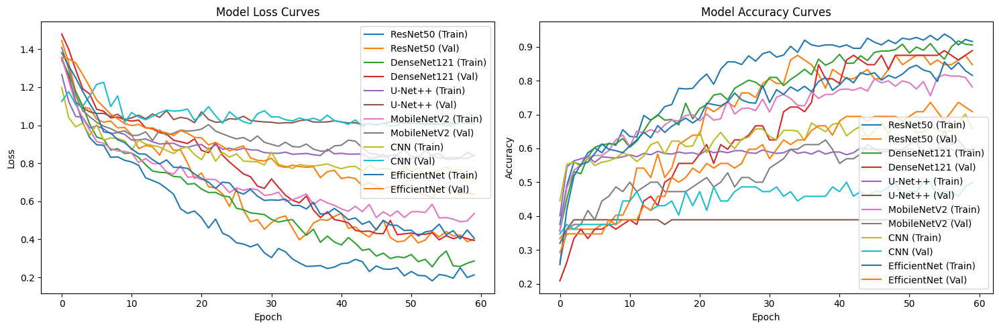

In [ ]:
# Eğitim eğrilerini çizme
plot_training_curves(histories, model_names)

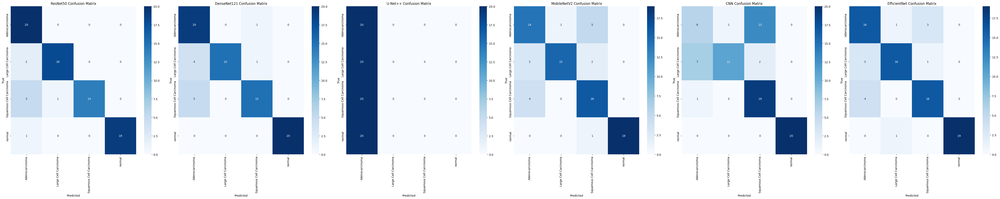

In [ ]:
# Karışıklık matrislerini çizme
plot_confusion_matrices(models, model_names, test_loader, device, train_loader.dataset.classes)

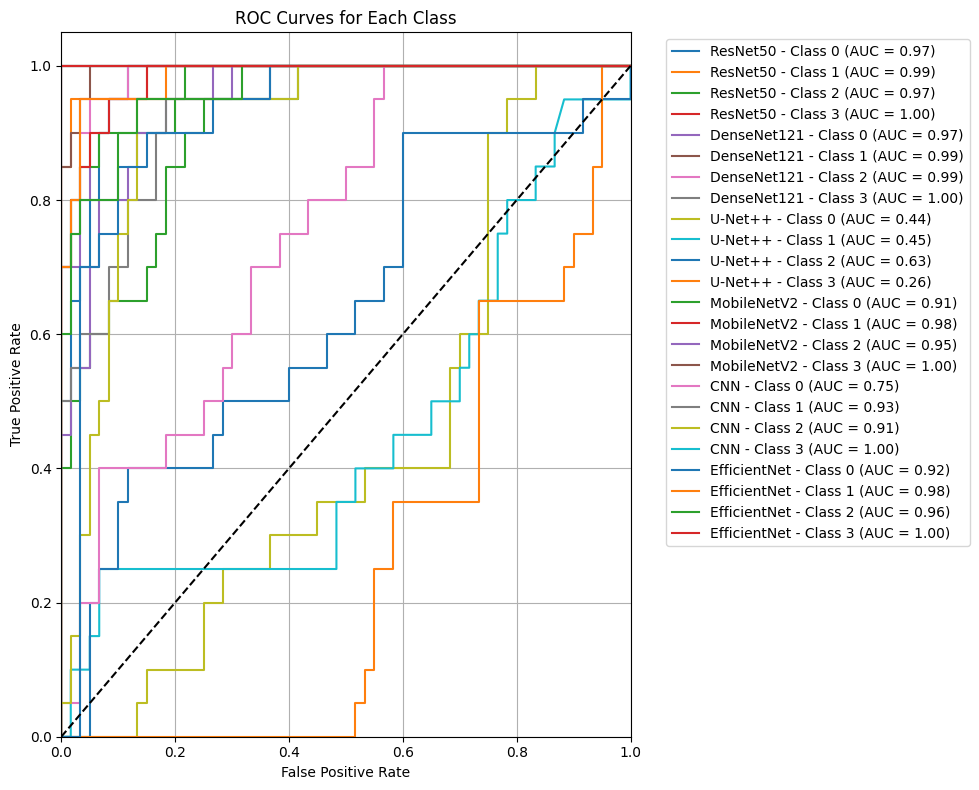

In [ ]:
# Her sınıf için ayrı ROC eğrisi
plot_roc_curves(models, model_names, test_loader, device)

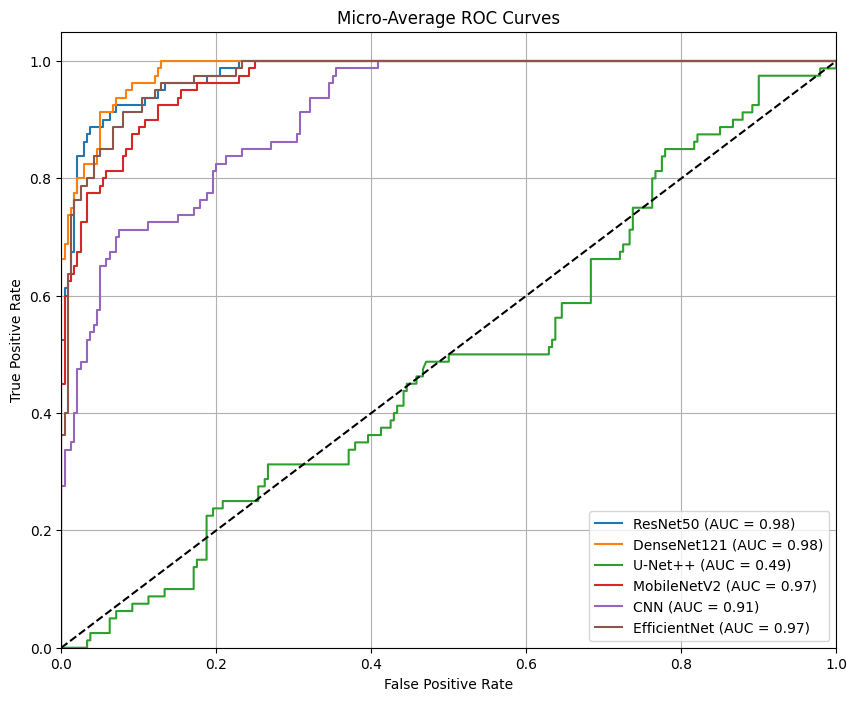

In [ ]:
# Mikro-ortalama ROC eğrisi
plot_micro_avg_roc_curves(models, model_names, test_loader, device)

In [ ]:
pip install colorama

  Using cached colorama-0.4.6-py2.py3-none-any.whl.metadata (17 kB)


In [ ]:
from tabulate import tabulate
from colorama import Fore, Style

# Sınıflandırma raporlarını yazdırma
for model, name in zip(models, model_names):
    preds, labels, _ = evaluate_model(model, test_loader, device)

    print(f"{Fore.CYAN}{'='*40}")
    print(f"{Fore.GREEN}Classification Report for Model: {name}{Style.RESET_ALL}")
    print(f"{Fore.CYAN}{'='*40}")

    report = classification_report(labels, preds, target_names=train_loader.dataset.classes, output_dict=True)
    table = [[key,
              f"{value['precision']:.2f}",
              f"{value['recall']:.2f}",
              f"{value['f1-score']:.2f}",
              value['support']] for key, value in report.items() if isinstance(value, dict)]

    headers = ["Class", "Precision", "Recall", "F1-Score", "Support"]
    print(tabulate(table, headers=headers, tablefmt="fancy_grid"))
    print("\n")

Classification Report for Model: ResNet50
╒═════════════════════════╤═════════════╤══════════╤════════════╤═══════════╕
│ Class                   │   Precision │   Recall │   F1-Score │   Support │
╞═════════════════════════╪═════════════╪══════════╪════════════╪═══════════╡
│ Adenocarcinoma          │        0.71 │     1    │       0.83 │        20 │
├─────────────────────────┼─────────────┼──────────┼────────────┼───────────┤
│ Large Cell Carcinoma    │        0.95 │     0.9  │       0.92 │        20 │
├─────────────────────────┼─────────────┼──────────┼────────────┼───────────┤
│ Squamous Cell Carcinoma │        1    │     0.7  │       0.82 │        20 │
├─────────────────────────┼─────────────┼──────────┼────────────┼───────────┤
│ normal                  │        1    │     0.95 │       0.97 │        20 │
├─────────────────────────┼─────────────┼──────────┼────────────┼───────────┤
│ macro avg               │        0.92 │     0.89 │       0.89 │        80 │
├─────────────────────

In [ ]:
import torch.nn.functional as F
from PIL import Image
import cv2

In [ ]:
class GradCAM:
    def __init__(self, model, target_layer):
        """
        Args:
            model: Eğitilmiş model (ResNet50, EfficientNet, CNN, MobileNetV2)
            target_layer: İncelenecek katman
        """
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.features = None

        # Hooks kayıt
        self.hooks = []
        self._register_hooks()

        # Model değerlendirme moduna alınır
        self.model.eval()

    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.features = output.detach()

        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0].detach()

        # Forward ve backward hookları kaydet
        forward_handle = self.target_layer.register_forward_hook(forward_hook)
        backward_handle = self.target_layer.register_backward_hook(backward_hook)

        self.hooks = [forward_handle, backward_handle]

    def remove_hooks(self):
        """Kayıtlı hookları temizle"""
        for hook in self.hooks:
            hook.remove()

    def generate_cam(self, input_tensor, target_class=None):
        """
        Grad-CAM ısı haritası oluştur
        Args:
            input_tensor: Model girişi (1, C, H, W)
            target_class: Hedef sınıf indeksi (None ise en yüksek olasılıklı sınıf)
        Returns:
            cam: Normalize edilmiş ısı haritası
            output: Model çıktısı
        """
        # Forward pass
        output = self.model(input_tensor)

        if target_class is None:
            target_class = output.argmax(dim=1).item()

        # Target için one-hot tensor oluştur
        one_hot = torch.zeros_like(output)
        one_hot[0][target_class] = 1

        # Backward pass
        output.backward(gradient=one_hot, retain_graph=True)

        # Gradient ve feature maps ağırlıklarını hesapla
        pooled_gradients = torch.mean(self.gradients, dim=[2, 3])
        for i in range(self.features.shape[1]):
            self.features[:, i, :, :] *= pooled_gradients[0, i][..., None, None]

        # Isı haritası oluştur
        cam = torch.mean(self.features, dim=1).squeeze()
        cam = F.relu(cam)  # Negatif değerleri sıfırla

        # Normalize et
        if torch.max(cam) > 0:
            cam = cam / torch.max(cam)

        return cam.detach().cpu().numpy(), output

In [ ]:
def visualize_gradcam(model, image_tensor, target_layer, target_class=None, original_image=None):
    """
    Grad-CAM görselleştirmesi oluştur ve göster
    Args:
        model: Eğitilmiş model
        image_tensor: Model girişi (1, C, H, W)
        target_layer: İncelenecek katman
        target_class: Hedef sınıf indeksi
        original_image: Orijinal görüntü (PIL Image veya numpy array)
    """
    # GradCAM nesnesini oluştur
    grad_cam = GradCAM(model, target_layer)

    # Isı haritası oluştur
    cam, output = grad_cam.generate_cam(image_tensor, target_class)

    # Orijinal görüntüyü numpy array'e dönüştür
    if original_image is None:
        # Normalize edilmiş tensor'ı görüntüye dönüştür
        original_image = image_tensor.squeeze().permute(1, 2, 0).cpu().numpy()
        original_image = (original_image * 255).astype(np.uint8)
    elif isinstance(original_image, Image.Image):
        original_image = np.array(original_image)

    # Isı haritasını yeniden boyutlandır
    cam_resized = cv2.resize(cam, (original_image.shape[1], original_image.shape[0]))

    # Isı haritası görselleştirmesi
    heatmap = cv2.applyColorMap(np.uint8(255 * cam_resized), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

    # Isı haritası ve orijinal görüntüyü birleştir
    superimposed = cv2.addWeighted(original_image, 0.6, heatmap, 0.4, 0)

    # Sonuçları göster
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

    ax1.imshow(original_image)
    ax1.set_title('Original Image')
    ax1.axis('off')

    ax2.imshow(heatmap)
    ax2.set_title('Grad-CAM Heatmap')
    ax2.axis('off')

    ax3.imshow(superimposed)
    ax3.set_title('Superimposed')
    ax3.axis('off')

    plt.tight_layout()
    plt.show()

    # Hookları temizle
    grad_cam.remove_hooks()

    return output

In [ ]:
# Kullanım örneği:
def analyze_model_focus(model, test_loader, class_names, num_images=5):
    """
    Test setinden rastgele görüntüler seçerek Grad-CAM analizi yap
    """
    model.eval()
    device = next(model.parameters()).device

    # ResNet50 için son konvolüsyonel katman
    if isinstance(model, ResNetLungCancer):
        target_layer = model.resnet.layer4[-1]
    # DenseNet121 için son dense block
    elif isinstance(model, DenseNetLungCancer):
        target_layer = model.densenet.features.denseblock4

    # EfficientNet için son konvolüsyonel katman
    elif isinstance(model, EfficientNetLungCancer):
        target_layer = model.efficientnet.features[-1]
    # CNN için son konvolüsyonel katman
    elif isinstance(model, SimpleCNN):
        target_layer = model.features[-2]  # Son ReLU'dan önceki Conv2d katmanı

    # MobileNetV2 için son konvolüsyonel katman
    elif isinstance(model, MobileNetV2LungCancer):
        target_layer = model.mobilenet.features[-1]

    # U-Net++ için son encoder katmanı
    else:
        target_layer = model.enc4

    dataiter = iter(test_loader)

    for i in range(num_images):
        images, labels = next(dataiter)
        image = images[0].unsqueeze(0).to(device)  # Tek bir görüntü al

        # Grad-CAM görselleştirmesi
        output = visualize_gradcam(model, image, target_layer)

        # Tahmin edilen sınıfı göster
        pred = output.argmax(dim=1).item()
        true_label = labels[0].item()

        print(f'\nGörüntü {i+1}:')
        print(f'Gerçek Sınıf: {class_names[true_label]}')
        print(f'Tahmin Edilen Sınıf: {class_names[pred]}')
        print('-' * 50)


ResNet50 Analizi:


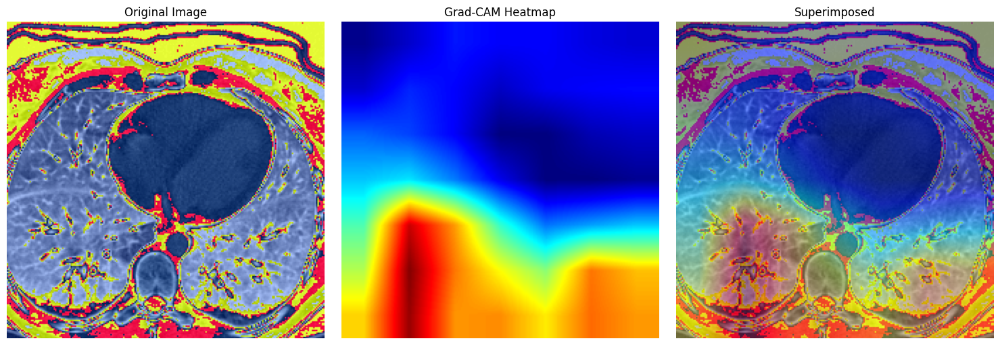


Görüntü 1:
Gerçek Sınıf: Adenocarcinoma
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------


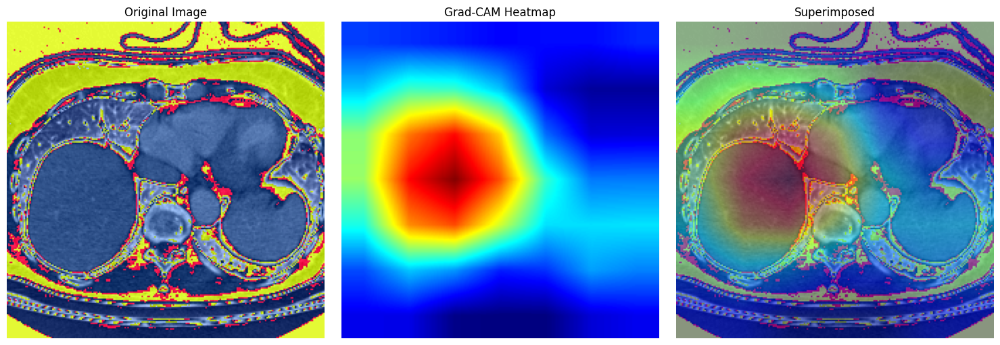


Görüntü 2:
Gerçek Sınıf: Large Cell Carcinoma
Tahmin Edilen Sınıf: Large Cell Carcinoma
--------------------------------------------------


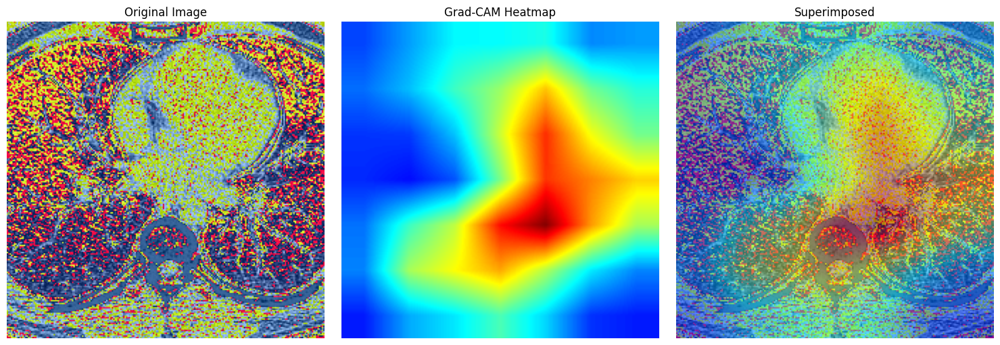


Görüntü 3:
Gerçek Sınıf: normal
Tahmin Edilen Sınıf: normal
--------------------------------------------------

DenseNet121 Analizi:


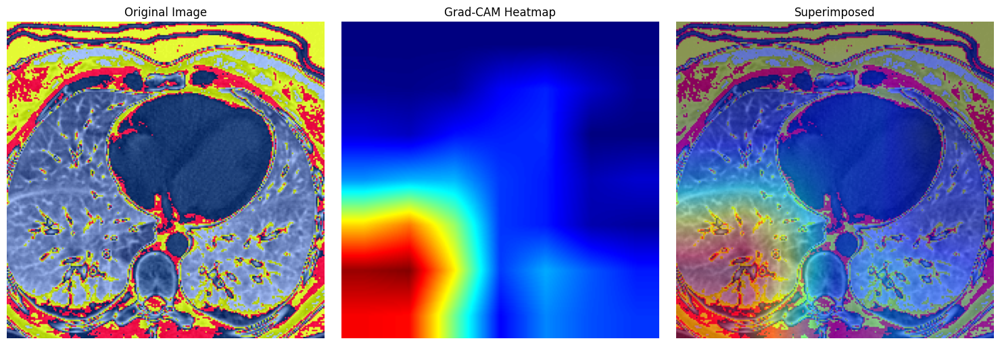


Görüntü 1:
Gerçek Sınıf: Adenocarcinoma
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------


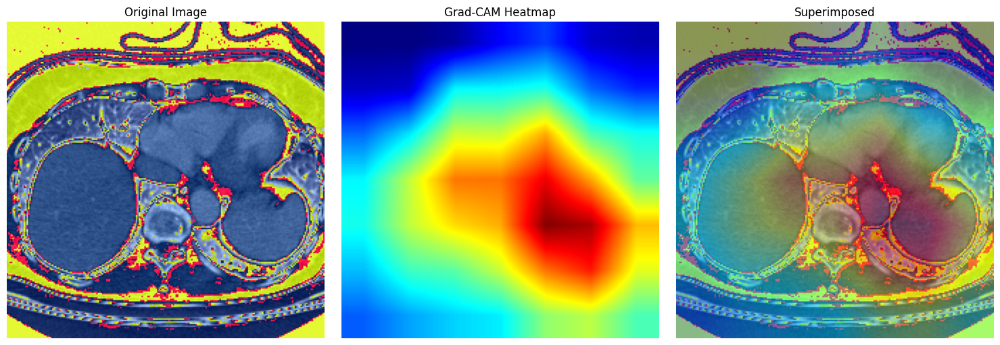


Görüntü 2:
Gerçek Sınıf: Large Cell Carcinoma
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------


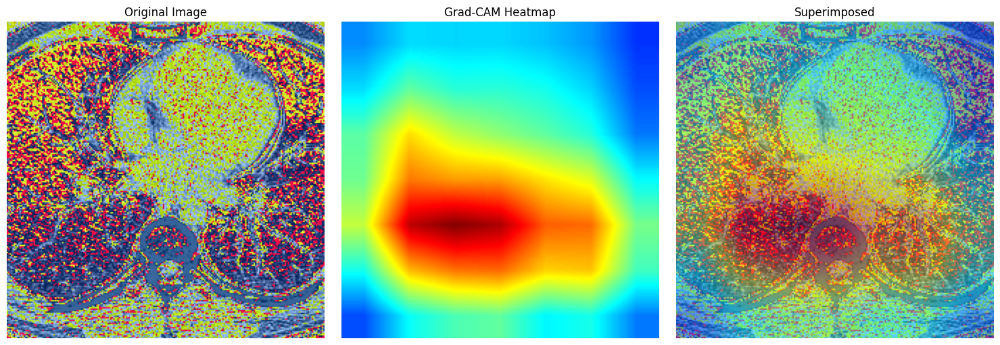


Görüntü 3:
Gerçek Sınıf: normal
Tahmin Edilen Sınıf: normal
--------------------------------------------------

U-Net++ Analizi:


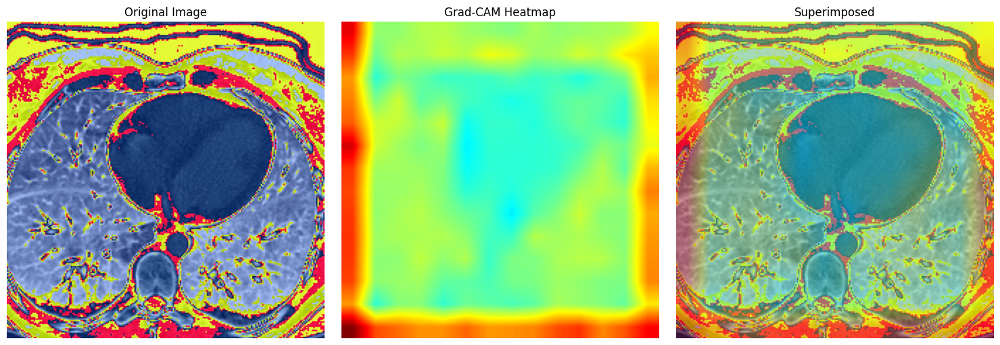


Görüntü 1:
Gerçek Sınıf: Adenocarcinoma
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------


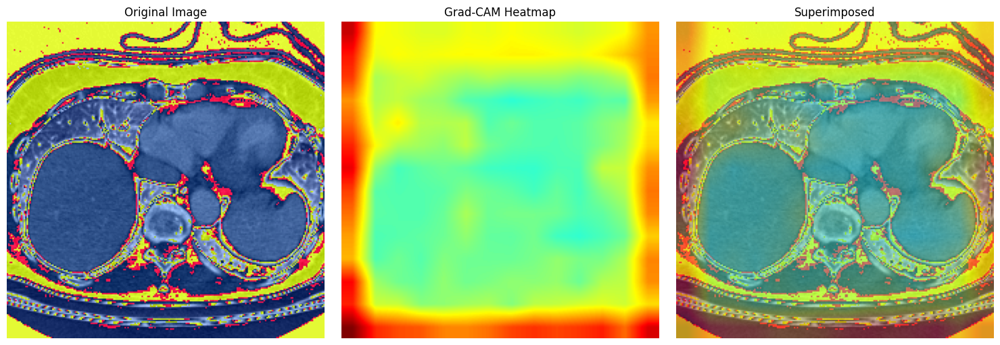


Görüntü 2:
Gerçek Sınıf: Large Cell Carcinoma
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------


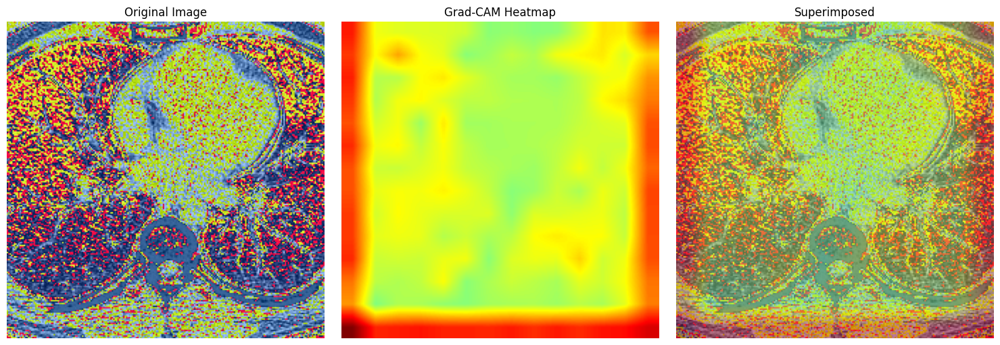


Görüntü 3:
Gerçek Sınıf: normal
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------

MobileNetV2 Analizi:


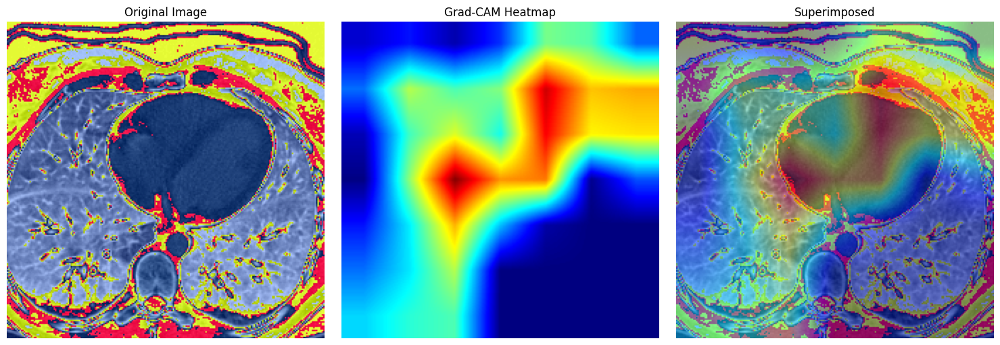


Görüntü 1:
Gerçek Sınıf: Adenocarcinoma
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------


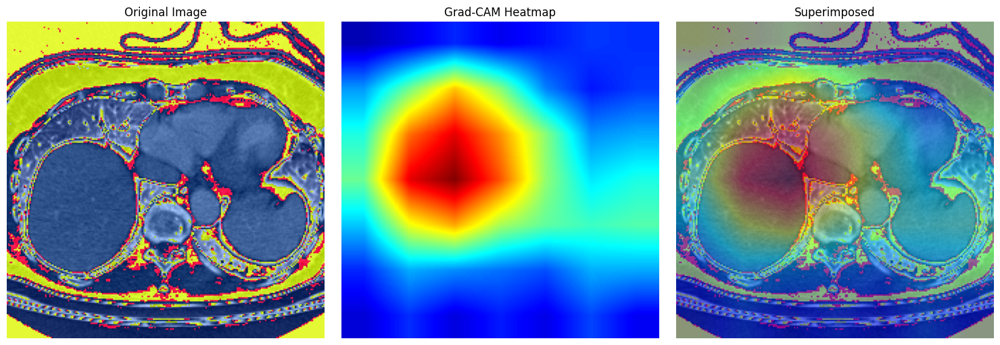


Görüntü 2:
Gerçek Sınıf: Large Cell Carcinoma
Tahmin Edilen Sınıf: Large Cell Carcinoma
--------------------------------------------------


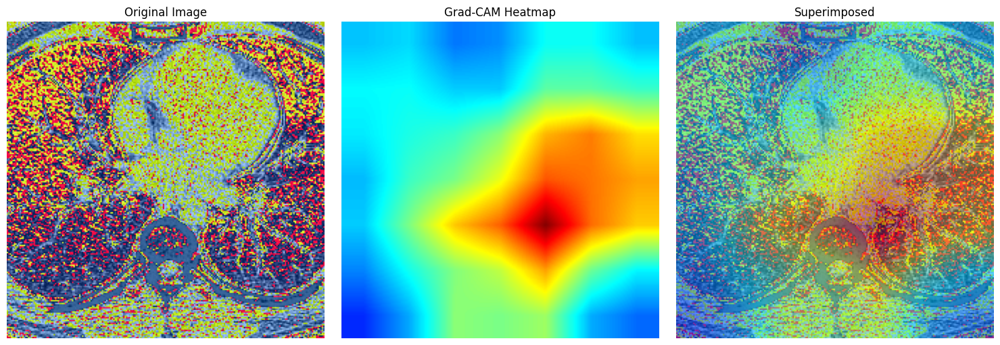


Görüntü 3:
Gerçek Sınıf: normal
Tahmin Edilen Sınıf: normal
--------------------------------------------------

CNN Analizi:


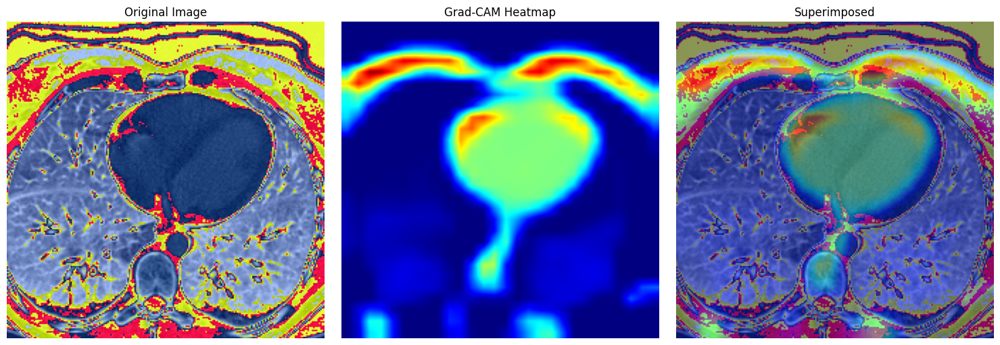


Görüntü 1:
Gerçek Sınıf: Adenocarcinoma
Tahmin Edilen Sınıf: Squamous Cell Carcinoma
--------------------------------------------------


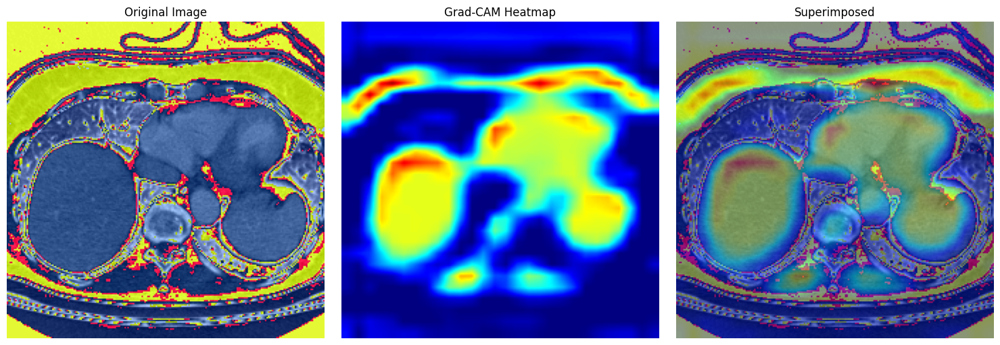


Görüntü 2:
Gerçek Sınıf: Large Cell Carcinoma
Tahmin Edilen Sınıf: Adenocarcinoma
--------------------------------------------------


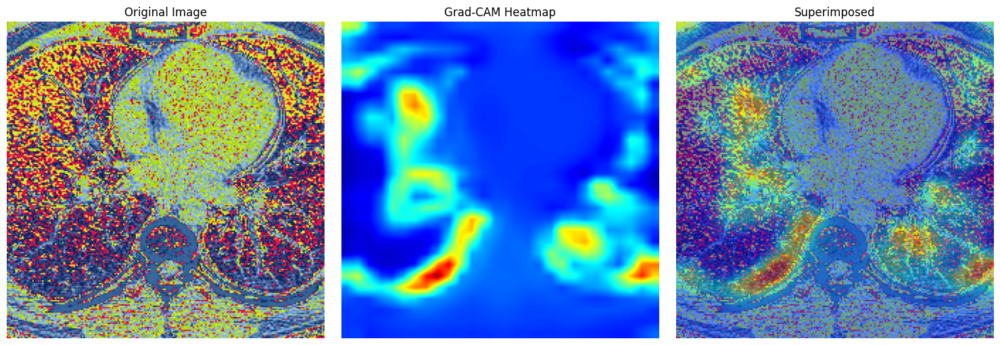


Görüntü 3:
Gerçek Sınıf: normal
Tahmin Edilen Sınıf: normal
--------------------------------------------------

EfficientNet Analizi:


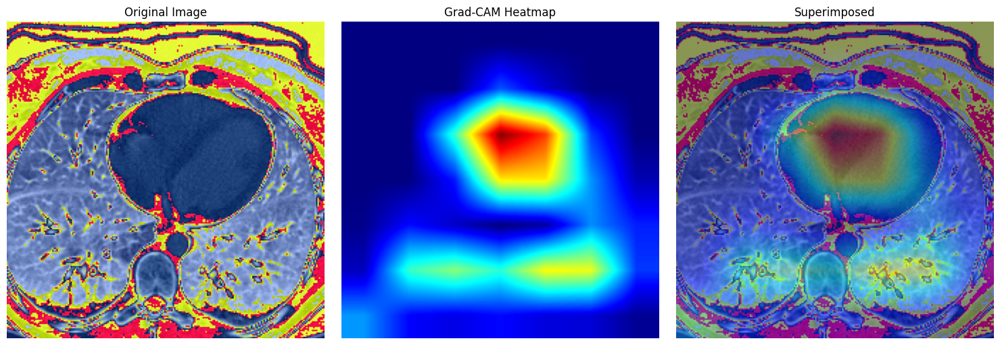


Görüntü 1:
Gerçek Sınıf: Adenocarcinoma
Tahmin Edilen Sınıf: Squamous Cell Carcinoma
--------------------------------------------------


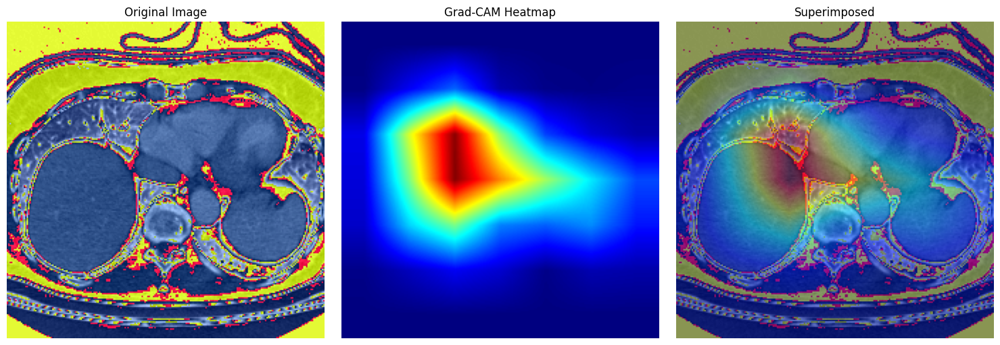


Görüntü 2:
Gerçek Sınıf: Large Cell Carcinoma
Tahmin Edilen Sınıf: Large Cell Carcinoma
--------------------------------------------------


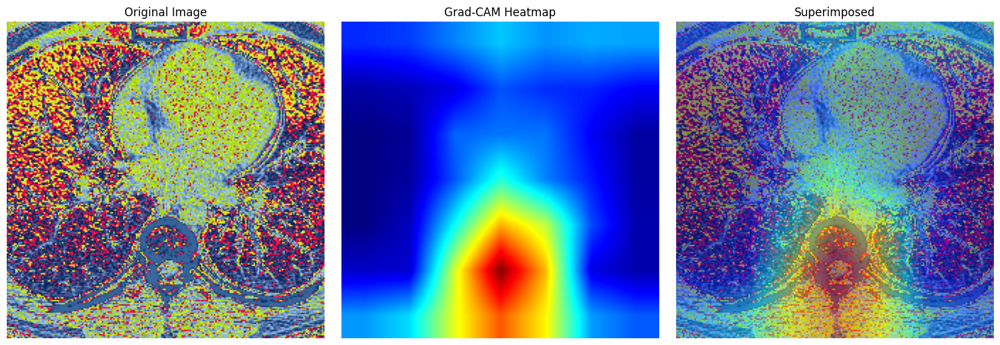


Görüntü 3:
Gerçek Sınıf: normal
Tahmin Edilen Sınıf: normal
--------------------------------------------------


In [ ]:
# Her model için ayrı ayrı analiz yapabilirsiniz
for model_name, model in zip(model_names, models):
    print(f"\n{model_name} Analizi:")
    print("=" * 50)
    analyze_model_focus(model, test_loader, train_loader.dataset.classes, num_images=3)

# Kaydedilen Modelin Kullanımı

In [ ]:
import torch
from PIL import Image
from torchvision import transforms

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

model = ResNetLungCancer(num_classes=4)
model.load_state_dict(torch.load('lung_cancer_resnet50_model.pth', map_location=device))
model = model.to(device)
model.eval()

preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# image from local file
image_path = "data/train/Large Cell Carcinoma/image_100.png"
image = Image.open(image_path).convert('RGB')

# preprocess the image
input_tensor = preprocess(image).unsqueeze(0).to(device)  # add batch dimension and move to device

# get model predictions
with torch.no_grad():
    output = model(input_tensor)

predicted_class = torch.argmax(output, dim=1).item()

class_names = ['Adenocarcinoma', 'Large Cell Carcinoma', 'Normal', 'Squamous Cell Carcinoma']

print(f"Predicted class: {class_names[predicted_class]}")

Predicted class: Large Cell Carcinoma
